In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import unicodedata
from re import sub

In [2]:
data = pd.read_csv("working.csv")

In [17]:
origData = pd.read_csv("bigCleaning.csv")

C:\Users\1king\AppData\Local\Temp\ipykernel_20680\4017451131.py:1: DtypeWarning: Columns (30,31,120,131,137,142,143,144,149,153,154,155,159,160,161,162,174,175,182,183,184,185,186,189,190,194,195,196,197,200,201,202,205,206,207,209,212,216,225,228,230,234,239,245,251,252,255,256,260,261,266,267,268,271,272,273,274,278,279,281,282,285,286,291,295,297,298,299,301,302,306,307,310,311,314,327,330,331,337,338,342,351,352,353,357,358,360,365,366,367,368,371,373,374,384,387,390,392,396,402,403,405,411,413,416,417,425,428,429,430,431,434,435,436,442,446,447,455,458,462,463,466,467,473,474,477,480,481,482,488,490,491,493,498,499,500,501,503,506,507,711,718,721,723,726,733,734,743,744,745,763,764,769,776,789,790,791,796,798,799,800,802,803,808,813,815,817,820,823,824,825,829,830,831,837,840,841,842,843,850,851,855,857,867,869,874,877,880,887,891,893,920,925,926,935,939,942,952,953,957,961,976,977,985,989,990,992,994,995,999,1002,1003,1005,1010,1015,1024,1026,1027,1028,1030,1031,1034,1035,1038,10

In [3]:
data = data.drop("Unnamed: 0", axis=1)

In [18]:
origData = origData.drop("Unnamed: 0", axis=1)

In [38]:
data.keys()[-20:]

Index(['pub_Furry Tails', 'dev_Labyrinthine', 'pub_Nexon America Inc.',
       'dev_Romantic Room', 'pub_Romantic Room', 'dev_Ironward',
       'dev_Racing Bros', 'pub_ANPA.US', 'numUpdates', 'lastUpdate', 'naccus',
       'esrb_ao', 'esrb_e', 'esrb_e10', 'esrb_ec', 'esrb_m', 'esrb_rp',
       'esrb_t', 'all-time_peak_ccu', 'last_30_days_avg_ccu'],
      dtype='object')

In [39]:
data["last_30_days_avg_ccu"] = np.log(data["last_30_days_avg_ccu"] + 1)

In [25]:
data.merge(origData[["all-time_peak_ccu", "appid", "last_30_days_avg_ccu"]], on="appid")

,appid,Name,Pos_Reviews,Neg_Reviews,Tot_Reviews,game_name,dlc,price,f2p,unavailable,...,ln.all-time_peak_ccu,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t,all-time_peak_ccu,last_30_days_avg_ccu
0,620,Portal 2,358880,4571,363451,Portal 2,1.0,9.99,False,False,...,9.614738,0,0,0,0,0,0,0,14984.0,5869.0
1,1118200,People Playground,211277,2723,214000,People Playground,0.0,9.99,False,False,...,9.657779,0,0,0,0,0,0,0,15643.0,15643.0
2,1794680,Vampire Survivors,208300,2928,211228,Vampire Survivors,3.0,4.99,False,False,...,11.252353,0,0,0,0,0,0,0,77061.0,12070.0
3,413150,Stardew Valley,597498,10823,608321,Stardew Valley,1.0,14.99,False,False,...,11.456133,0,0,1,0,0,0,0,94479.0,48881.0
4,1145360,Hades,231236,3554,234790,Hades,1.0,24.99,False,False,...,10.534387,0,0,0,0,0,0,1,37586.0,6541.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9956,294020,Merchants of Kaidan,333,160,493,Merchants of Kaidan,0.0,14.99,False,False,...,7.434848,0,0,0,0,0,0,0,1694.0,16.0
9957,451780,Trillion,305,146,451,Trillion: God of Destruction,1.0,9.99,False,False,...,6.302619,0,0,0,0,0,0,1,NaN,NaN
9958,1075140,Super Friends Party,269,128,397,Super Friends Party,0.0,0.00,True,False,...,6.302619,0,0,0,0,0,0,0,NaN,NaN
9959,264140,Pixel Piracy,4815,2490,7305,Pixel Piracy,2.0,14.99,False,False,...,7.671361,0,0,0,0,0,0,0,2146.0,22.0


In [36]:
data = data.drop("last_30_days_avg_ccu", axis=1)

In [28]:
data = data.drop("ln.all-time_peak_ccu", axis=1)

In [37]:
data = data.merge(origData[["appid", "last_30_days_avg_ccu"]], on="appid")

In [40]:
data

,appid,Name,Pos_Reviews,Neg_Reviews,Tot_Reviews,game_name,dlc,price,f2p,unavailable,...,naccus,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t,all-time_peak_ccu,last_30_days_avg_ccu
0,620,Portal 2,358880,4571,363451,Portal 2,1.0,9.99,False,False,...,False,0,0,0,0,0,0,0,9.614738,8.677610
1,1118200,People Playground,211277,2723,214000,People Playground,0.0,9.99,False,False,...,False,0,0,0,0,0,0,0,9.657779,9.657843
2,1794680,Vampire Survivors,208300,2928,211228,Vampire Survivors,3.0,4.99,False,False,...,False,0,0,0,0,0,0,0,11.252353,9.398561
3,413150,Stardew Valley,597498,10823,608321,Stardew Valley,1.0,14.99,False,False,...,False,0,0,1,0,0,0,0,11.456133,10.797165
4,1145360,Hades,231236,3554,234790,Hades,1.0,24.99,False,False,...,False,0,0,0,0,0,0,1,10.534387,8.785998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9956,294020,Merchants of Kaidan,333,160,493,Merchants of Kaidan,0.0,14.99,False,False,...,False,0,0,0,0,0,0,0,7.434848,2.833213
9957,451780,Trillion,305,146,451,Trillion: God of Destruction,1.0,9.99,False,False,...,True,0,0,0,0,0,0,1,NaN,NaN
9958,1075140,Super Friends Party,269,128,397,Super Friends Party,0.0,0.00,True,False,...,True,0,0,0,0,0,0,0,NaN,NaN
9959,264140,Pixel Piracy,4815,2490,7305,Pixel Piracy,2.0,14.99,False,False,...,False,0,0,0,0,0,0,0,7.671361,3.135494


In [32]:
origData

,appid,Name,Pos_Reviews,Neg_Reviews,Tot_Reviews,all-time_peak_ccu,last_30_days_avg_ccu,game_name,dlc,price,...,pub_Furry Tails,dev_Labyrinthine,pub_Nexon America Inc.,dev_Romantic Room,pub_Romantic Room,dev_Ironward,dev_Racing Bros,pub_ANPA.US,numUpdates,lastUpdate
0,620,Portal 2,358880,4571,363451,14984.0,5869.0,Portal 2,1.0,9.99,...,False,False,False,False,False,False,False,False,17.0,1.682533e+09
1,1118200,People Playground,211277,2723,214000,15643.0,15643.0,People Playground,0.0,9.99,...,False,False,False,False,False,False,False,False,51.0,1.691801e+09
2,1794680,Vampire Survivors,208300,2928,211228,77061.0,12070.0,Vampire Survivors,3.0,4.99,...,False,False,False,False,False,False,False,False,13.0,1.694679e+09
3,413150,Stardew Valley,597498,10823,608321,94479.0,48881.0,Stardew Valley,1.0,14.99,...,False,False,False,False,False,False,False,False,21.0,1.640117e+09
4,1145360,Hades,231236,3554,234790,37586.0,6541.0,Hades,1.0,24.99,...,False,False,False,False,False,False,False,False,20.0,1.644963e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10425,294020,Merchants of Kaidan,333,160,493,1694.0,16.0,Merchants of Kaidan,0.0,14.99,...,False,False,False,False,False,False,False,False,10.0,1.425585e+09
10426,451780,Trillion,305,146,451,NaN,NaN,Trillion: God of Destruction,1.0,9.99,...,False,False,False,False,False,False,False,False,0.0,0.000000e+00
10427,1075140,Super Friends Party,269,128,397,NaN,NaN,Super Friends Party,0.0,NaN,...,False,False,False,False,False,False,False,False,0.0,0.000000e+00
10428,264140,Pixel Piracy,4815,2490,7305,2146.0,22.0,Pixel Piracy,2.0,14.99,...,False,False,False,False,False,False,False,False,13.0,1.684143e+09


In [42]:
data.keys()[-20:]

Index(['pub_Furry Tails', 'dev_Labyrinthine', 'pub_Nexon America Inc.',
       'dev_Romantic Room', 'pub_Romantic Room', 'dev_Ironward',
       'dev_Racing Bros', 'pub_ANPA.US', 'numUpdates', 'lastUpdate', 'naccus',
       'esrb_ao', 'esrb_e', 'esrb_e10', 'esrb_ec', 'esrb_m', 'esrb_rp',
       'esrb_t', 'all-time_peak_ccu', 'last_30_days_avg_ccu'],
      dtype='object')

In [43]:
data.keys()[:20]

Index(['appid', 'Name', 'Pos_Reviews', 'Neg_Reviews', 'Tot_Reviews',
       'game_name', 'dlc', 'price', 'f2p', 'unavailable', 'release_date',
       'curators', 'steam_achievements', 'Single-player', 'Online Co-op',
       'Shared/Split Screen Co-op', 'Steam Achievements',
       'Full controller support', 'Steam Trading Cards', 'Captions available'],
      dtype='object')

In [4]:
naCols = data.isna().sum()
naCols = naCols[naCols > 0]
naCols

Series([], dtype: int64)

In [214]:
data = data.dropna(subset="price")

In [225]:
data.dtypes[data.dtypes == object]

Name            object
game_name       object
release_date    object
esrbRating      object
dtype: object

In [235]:
pd.get_dummies(data["esrbRating"], prefix="esrb", prefix_sep="_", drop_first=True)

,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t
0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0
3,0,0,1,0,0,0,0
4,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...
10425,0,0,0,0,0,0,0
10426,0,0,0,0,0,0,1
10427,0,0,0,0,0,0,0
10428,0,0,0,0,0,0,0


In [236]:
data2 = pd.concat([data, pd.get_dummies(data["esrbRating"], prefix="esrb", prefix_sep="_", drop_first=True)], axis=1)

In [238]:
data = data2

In [239]:
data

,appid,Name,Pos_Reviews,Neg_Reviews,Tot_Reviews,last_30_days_avg_ccu,game_name,dlc,price,f2p,...,naccus,ln.all-time_peak_ccu,missing_storage,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t
0,620,Portal 2,358880,4571,363451,8.677440,Portal 2,1.0,9.99,False,...,False,9.614738,False,0,0,0,0,0,0,0
1,1118200,People Playground,211277,2723,214000,9.657779,People Playground,0.0,9.99,False,...,False,9.657779,False,0,0,0,0,0,0,0
2,1794680,Vampire Survivors,208300,2928,211228,9.398478,Vampire Survivors,3.0,4.99,False,...,False,11.252353,False,0,0,0,0,0,0,0
3,413150,Stardew Valley,597498,10823,608321,10.797144,Stardew Valley,1.0,14.99,False,...,False,11.456133,False,0,0,1,0,0,0,0
4,1145360,Hades,231236,3554,234790,8.785845,Hades,1.0,24.99,False,...,False,10.534387,False,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10425,294020,Merchants of Kaidan,333,160,493,2.772589,Merchants of Kaidan,0.0,14.99,False,...,False,7.434848,False,0,0,0,0,0,0,0
10426,451780,Trillion,305,146,451,3.610918,Trillion: God of Destruction,1.0,9.99,False,...,True,6.302619,False,0,0,0,0,0,0,1
10427,1075140,Super Friends Party,269,128,397,3.610918,Super Friends Party,0.0,0.00,True,...,True,6.302619,False,0,0,0,0,0,0,0
10428,264140,Pixel Piracy,4815,2490,7305,3.091042,Pixel Piracy,2.0,14.99,False,...,False,7.671361,False,0,0,0,0,0,0,0


In [240]:
data = data.drop("missing_storage", axis=1)

In [249]:
data.dtypes[data.dtypes == object]

Name         object
game_name    object
dtype: object

In [243]:
data = data.drop("esrbRating", axis=1)

In [248]:
data["release_date"] = pd.to_datetime(data["release_date"])

In [250]:
toModel = data.drop("Name", axis=1)

In [253]:
toModel = toModel.drop("game_name", axis=1)

In [264]:
toModel["release_date"] = pd.to_datetime(toModel["release_date"]).astype(np.int64)

In [270]:
cMatrix = toModel.corr()

In [326]:
fig, ax = plt.subplots()
fig.set_size_inches(500, 400, forward=True)
fig.set_dpi(100)

In [327]:
hm = sns.heatmap(cMatrix, ax=ax)

In [328]:
fig

In [325]:
sns.set(font_scale=1.4)

In [298]:
data.to_csv("working.csv")

In [44]:
cMatrix = data.corr()

C:\Users\1king\AppData\Local\Temp\ipykernel_20680\533860344.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  cMatrix = data.corr()


In [54]:
cMatrix

,appid,Pos_Reviews,Neg_Reviews,Tot_Reviews,dlc,price,f2p,unavailable,curators,steam_achievements,...,naccus,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t,all-time_peak_ccu,last_30_days_avg_ccu
appid,1.000000,-0.059643,-0.049438,-0.058799,-0.011013,0.008924,0.174951,-0.026814,-0.188322,-0.023623,...,-0.091587,0.000125,-0.078198,-0.098064,-0.013982,-0.159479,-0.029912,-0.151478,-0.100036,0.068523
Pos_Reviews,-0.059643,1.000000,0.936704,0.999076,0.016039,0.064005,0.022927,0.002005,0.765324,0.014435,...,-0.054639,-0.002074,-0.007862,0.006157,-0.001857,0.070021,0.001747,0.018284,0.254610,0.280926
Neg_Reviews,-0.049438,0.936704,1.000000,0.950883,0.016117,0.065057,0.039956,0.001995,0.633186,0.010501,...,-0.048136,-0.001432,-0.008066,-0.000195,-0.001758,0.075197,0.002852,0.033299,0.235420,0.253897
Tot_Reviews,-0.058799,0.999076,0.950883,1.000000,0.016159,0.064573,0.025174,0.002018,0.754346,0.014051,...,-0.054215,-0.002009,-0.007941,0.005420,-0.001857,0.071135,0.001895,0.020252,0.254001,0.279535
dlc,-0.011013,0.016039,0.016117,0.016159,1.000000,0.064570,-0.007186,0.018966,0.026754,0.033585,...,-0.028113,-0.001295,0.003606,-0.001781,-0.000958,0.010007,-0.000701,0.026606,0.046998,0.066106
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
esrb_m,-0.159479,0.070021,0.075197,0.071135,0.010007,0.203484,-0.086740,0.030242,0.191056,-0.005536,...,-0.084972,-0.007285,-0.057495,-0.055084,-0.005506,1.000000,-0.011359,-0.086316,0.204606,0.173063
esrb_rp,-0.029912,0.001747,0.002852,0.001895,-0.000701,0.013881,-0.011252,-0.008435,0.019244,-0.000523,...,-0.000041,-0.001096,-0.008653,-0.008291,-0.000829,-0.011359,1.000000,-0.012991,0.010182,-0.010623
esrb_t,-0.151478,0.018284,0.033299,0.020252,0.026606,0.195973,-0.065925,0.002222,0.052871,-0.007410,...,-0.074413,-0.008332,-0.065758,-0.063000,-0.006298,-0.086316,-0.012991,1.000000,0.150501,0.128393
all-time_peak_ccu,-0.100036,0.254610,0.235420,0.254001,0.046998,0.324413,-0.027468,-0.018311,0.409187,0.076070,...,NaN,-0.009050,-0.035867,0.035087,-0.002879,0.204606,0.010182,0.150501,1.000000,0.757177


In [93]:
for x in cMatrix:
    cMatrix[x][x] = 0

In [94]:
toOut = cMatrix[np.abs(cMatrix) > 0.8].dropna(how="all")

In [83]:
reducedCMatrix = []
toDelete = set([])
toKeep = set([])
for x in toOut.iterrows():
    firstVar = x[0]
    if firstVar == "price":
        continue
    
    if firstVar not in toDelete:
        toKeep.add(firstVar)
        s = x[1]
        s = [x for x in s.dropna().keys()]
        for y in s:
            toDelete.add(y)
        if "price" in s:
            s.remove("price")
        reducedCMatrix.append((firstVar, s))
        print((firstVar, s))

('Pos_Reviews', ['Neg_Reviews', 'Tot_Reviews'])
('f2p', ['genre_Free to Play'])
('Remote Play on Phone', ['Remote Play on Tablet'])
('French-interface', ['German-interface', 'Spanish - Spain-interface'])
('French-fullAudio', ['German-fullAudio', 'Spanish - Spain-fullAudio', 'Italian-fullAudio'])
('French-subtitles', ['German-subtitles', 'Spanish - Spain-subtitles'])
('Czech-fullAudio', ['Hungarian-fullAudio'])
('Danish-fullAudio', ['Dutch-fullAudio', 'Finnish-fullAudio', 'Hungarian-fullAudio', 'Norwegian-fullAudio', 'Romanian-fullAudio', 'Swedish-fullAudio', 'Thai-fullAudio', 'Bulgarian-fullAudio', 'Greek-fullAudio', 'Arabic-fullAudio'])
('Finnish-interface', ['Norwegian-interface'])
('Finnish-subtitles', ['Norwegian-subtitles'])
('Traditional Chinese-interface', ['Traditional Chinese-subtitles'])
('Spanish - Latin America-interface', ['Spanish - Latin America-subtitles'])
('Ukrainian-fullAudio', ['Romanian-fullAudio', 'Bulgarian-fullAudio', 'Greek-fullAudio'])
('dev_Valve', ['pub_Valv

In [84]:
toDelete

{'Afrikaans-fullAudio',
 'Afrikaans-interface',
 'Afrikaans-subtitles',
 'Albanian-fullAudio',
 'Albanian-interface',
 'Albanian-subtitles',
 'Amharic-fullAudio',
 'Amharic-interface',
 'Amharic-subtitles',
 'Arabic-fullAudio',
 'Armenian-fullAudio',
 'Armenian-interface',
 'Armenian-subtitles',
 'Assamese-fullAudio',
 'Assamese-interface',
 'Assamese-subtitles',
 'Azerbaijani-fullAudio',
 'Azerbaijani-interface',
 'Azerbaijani-subtitles',
 'Bangla-fullAudio',
 'Bangla-interface',
 'Bangla-subtitles',
 'Basque-fullAudio',
 'Basque-interface',
 'Basque-subtitles',
 'Belarusian-fullAudio',
 'Belarusian-subtitles',
 'Bosnian-fullAudio',
 'Bosnian-interface',
 'Bosnian-subtitles',
 'Bulgarian-fullAudio',
 'Catalan-fullAudio',
 'Catalan-subtitles',
 'Cherokee-fullAudio',
 'Cherokee-interface',
 'Cherokee-subtitles',
 'Croatian-fullAudio',
 'Croatian-interface',
 'Croatian-subtitles',
 'DLCs',
 'Dari-fullAudio',
 'Dari-interface',
 'Dari-subtitles',
 'Dutch-fullAudio',
 'Estonian-fullAudio',

In [85]:
toKeep

{'Belarusian-interface',
 'Catalan-interface',
 'Czech-fullAudio',
 'Danish-fullAudio',
 'Finnish-interface',
 'Finnish-subtitles',
 'French-fullAudio',
 'French-interface',
 'French-subtitles',
 'Hindi-interface',
 'Indonesian-fullAudio',
 'Indonesian-interface',
 'Lithuanian-interface',
 'Malay-interface',
 'Pos_Reviews',
 'Remote Play on Phone',
 'Slovak-interface',
 'Spanish - Latin America-interface',
 'Tracked Controller Support',
 'Traditional Chinese-interface',
 'Ukrainian-fullAudio',
 'dev_0 Deer Soft',
 'dev_10tons Ltd',
 'dev_430Games',
 'dev_9Garden',
 'dev_@unepic_fran',
 'dev_ADOG',
 'dev_ALICE IN DISSONANCE',
 'dev_AQUAPLUS',
 'dev_Abbey Games',
 'dev_Adamvision Studios',
 'dev_Aether Studios',
 'dev_Afterburn',
 'dev_Alda Games',
 'dev_Aleksandr Golovkin',
 'dev_Alexey Davydov',
 'dev_Alice & Smith',
 'dev_Alien Pixel Studios',
 'dev_Alientrap',
 'dev_Amanita Design',
 'dev_Anatoliy Loginovskikh',
 'dev_Animu Game',
 'dev_Arcen Games, LLC',
 'dev_Artless Games',
 'dev_

In [86]:
data = data.drop([x for x in toDelete], axis=1)

In [88]:
cMatrix = data.corr()

C:\Users\1king\AppData\Local\Temp\ipykernel_20680\533860344.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  cMatrix = data.corr()


In [97]:
data = data.drop("game_name", axis=1)

In [102]:
data.sum()[data.sum() == 0]

dev_Epic Games, Inc.        0
pub_Epic Games, Inc.        0
dev_Matt Newell             0
pub_Matt Newell             0
pub_Telltale Games          0
dev_Related Designs         0
dev_Stainless Games         0
dev_Slightly Mad Studios    0
pub_Aeria Games             0
dev_Cartoon Game            0
pub_Cartoon Game            0
dtype: object

In [104]:
data = data.drop(["dev_Epic Games, Inc.", "pub_Epic Games, Inc.", "dev_Matt Newell", "pub_Matt Newell", "pub_Telltale Games", "dev_Related Designs", "dev_Stainless Games", "dev_Slightly Mad Studios", "pub_Aeria Games", "dev_Cartoon Game", "pub_Cartoon Game"], axis=1)

In [105]:
data

,appid,Name,Pos_Reviews,dlc,price,f2p,unavailable,release_date,curators,steam_achievements,...,naccus,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t,all-time_peak_ccu,last_30_days_avg_ccu
0,620,Portal 2,358880,1.0,9.99,False,False,2011-04-18,3930.0,51.0,...,False,0,0,0,0,0,0,0,9.614738,8.677610
1,1118200,People Playground,211277,0.0,9.99,False,False,2019-07-23,344.0,17.0,...,False,0,0,0,0,0,0,0,9.657779,9.657843
2,1794680,Vampire Survivors,208300,3.0,4.99,False,False,2022-10-20,680.0,196.0,...,False,0,0,0,0,0,0,0,11.252353,9.398561
3,413150,Stardew Valley,597498,1.0,14.99,False,False,2016-02-26,2548.0,40.0,...,False,0,0,1,0,0,0,0,11.456133,10.797165
4,1145360,Hades,231236,1.0,24.99,False,False,2020-09-17,947.0,49.0,...,False,0,0,0,0,0,0,1,10.534387,8.785998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9956,294020,Merchants of Kaidan,333,0.0,14.99,False,False,2014-11-10,20.0,22.0,...,False,0,0,0,0,0,0,0,7.434848,2.833213
9957,451780,Trillion,305,1.0,9.99,False,False,2016-11-07,47.0,36.0,...,True,0,0,0,0,0,0,1,NaN,NaN
9958,1075140,Super Friends Party,269,0.0,0.00,True,False,2019-06-14,4.0,0.0,...,True,0,0,0,0,0,0,0,NaN,NaN
9959,264140,Pixel Piracy,4815,2.0,14.99,False,False,2015-04-23,230.0,31.0,...,False,0,0,0,0,0,0,0,7.671361,3.135494


In [108]:
data.sum()[data.sum() == 1].keys()

Index(['pub_Skunkape Games',
       'pub_Beijing New Era Network Technology Co., Ltd.', 'dev_OneShark',
       'dev_Konami Digital Entertainment', 'pub_Nyu Media',
       'dev_B.B.STUDIO CO.,LTD.', 'pub_NCSOFT', 'pub_Wizards of the Coast LLC',
       'pub_Dovetail Games - TSW', 'dev_Nimble Neuron', 'dev_Moss Co., Ltd.',
       'dev_Soccer Manager Ltd', 'dev_Nimble Giant Entertainment'],
      dtype='object')

In [109]:
data = data.drop(['pub_Skunkape Games',
       'pub_Beijing New Era Network Technology Co., Ltd.', 'dev_OneShark',
       'dev_Konami Digital Entertainment', 'pub_Nyu Media',
       'dev_B.B.STUDIO CO.,LTD.', 'pub_NCSOFT', 'pub_Wizards of the Coast LLC',
       'pub_Dovetail Games - TSW', 'dev_Nimble Neuron', 'dev_Moss Co., Ltd.',
       'dev_Soccer Manager Ltd', 'dev_Nimble Giant Entertainment'], axis=1)

In [110]:
data

,appid,Name,Pos_Reviews,dlc,price,f2p,unavailable,release_date,curators,steam_achievements,...,naccus,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t,all-time_peak_ccu,last_30_days_avg_ccu
0,620,Portal 2,358880,1.0,9.99,False,False,2011-04-18,3930.0,51.0,...,False,0,0,0,0,0,0,0,9.614738,8.677610
1,1118200,People Playground,211277,0.0,9.99,False,False,2019-07-23,344.0,17.0,...,False,0,0,0,0,0,0,0,9.657779,9.657843
2,1794680,Vampire Survivors,208300,3.0,4.99,False,False,2022-10-20,680.0,196.0,...,False,0,0,0,0,0,0,0,11.252353,9.398561
3,413150,Stardew Valley,597498,1.0,14.99,False,False,2016-02-26,2548.0,40.0,...,False,0,0,1,0,0,0,0,11.456133,10.797165
4,1145360,Hades,231236,1.0,24.99,False,False,2020-09-17,947.0,49.0,...,False,0,0,0,0,0,0,1,10.534387,8.785998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9956,294020,Merchants of Kaidan,333,0.0,14.99,False,False,2014-11-10,20.0,22.0,...,False,0,0,0,0,0,0,0,7.434848,2.833213
9957,451780,Trillion,305,1.0,9.99,False,False,2016-11-07,47.0,36.0,...,True,0,0,0,0,0,0,1,NaN,NaN
9958,1075140,Super Friends Party,269,0.0,0.00,True,False,2019-06-14,4.0,0.0,...,True,0,0,0,0,0,0,0,NaN,NaN
9959,264140,Pixel Piracy,4815,2.0,14.99,False,False,2015-04-23,230.0,31.0,...,False,0,0,0,0,0,0,0,7.671361,3.135494


In [111]:
data.sum()[data.sum() == 2].keys()

Index(['dev_Moon Studios GmbH', 'pub_Paradise Project', 'dev_Dodge Roll',
       'dev_etherane', 'dev_BEHEMUTT', 'pub_Frozen District',
       'dev_SkyBox Labs', 'dev_Big Huge Games', 'dev_NotGames',
       'dev_Monolith Productions, Inc.', 'dev_Sports Interactive',
       'dev_Blue Wizard Digital', 'dev_Laminar Research', 'dev_Flashbulb',
       'dev_Morteshka', 'dev_Playsaurus', 'dev_Alien Pixel Studios',
       'dev_Acclaim Studios Teesside', 'dev_Klace', 'pub_East2West Games',
       'dev_Days of Wonder', 'dev_Out of the Park Developments',
       'dev_Resolution Games', 'dev_Hyper Hippo Games', 'dev_Blue Byte',
       'dev_Rockstar North', 'dev_Con Artist Games', 'dev_Sicarius',
       'dev_Terminal Reality', 'dev_Criterion Games', 'dev_Hologryph',
       'dev_Team Jolly Roger', 'dev_Black Eye Games', 'dev_Undead Labs',
       'dev_KishMish Games', 'dev_Infinite Interactive', 'pub_Retroism',
       'pub_LoveStoryProject', 'dev_Visual Concepts', 'pub_Gameforge 4D GmbH',
       'dev

In [112]:
data = data.drop(['dev_Moon Studios GmbH', 'pub_Paradise Project', 'dev_Dodge Roll',
       'dev_etherane', 'dev_BEHEMUTT', 'pub_Frozen District',
       'dev_SkyBox Labs', 'dev_Big Huge Games', 'dev_NotGames',
       'dev_Monolith Productions, Inc.', 'dev_Sports Interactive',
       'dev_Blue Wizard Digital', 'dev_Laminar Research', 'dev_Flashbulb',
       'dev_Morteshka', 'dev_Playsaurus', 'dev_Alien Pixel Studios',
       'dev_Acclaim Studios Teesside', 'dev_Klace', 'pub_East2West Games',
       'dev_Days of Wonder', 'dev_Out of the Park Developments',
       'dev_Resolution Games', 'dev_Hyper Hippo Games', 'dev_Blue Byte',
       'dev_Rockstar North', 'dev_Con Artist Games', 'dev_Sicarius',
       'dev_Terminal Reality', 'dev_Criterion Games', 'dev_Hologryph',
       'dev_Team Jolly Roger', 'dev_Black Eye Games', 'dev_Undead Labs',
       'dev_KishMish Games', 'dev_Infinite Interactive', 'pub_Retroism',
       'pub_LoveStoryProject', 'dev_Visual Concepts', 'pub_Gameforge 4D GmbH',
       'dev_Digital Leisure Inc.', 'dev_Egidijus Bachur',
       'dev_Gravity Interactive'], axis=1)

In [170]:
toEda = data[data.dtypes[(data.dtypes == np.int64) | (data.dtypes == np.float64)].keys()].drop(["esrb_ao", "esrb_e", "esrb_e10", "esrb_ec", "esrb_m", "esrb_rp", "esrb_t"], axis=1)

<Axes: >

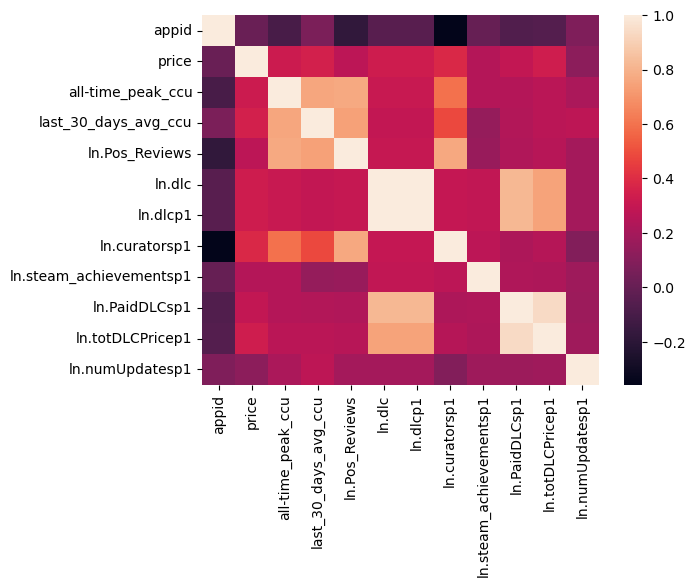

In [172]:
sns.heatmap(toEda.corr())

In [147]:
data["ln.Pos_Reviews"] = np.log(data["Pos_Reviews"])

In [148]:
data = data.drop("Pos_Reviews", axis=1)

In [152]:
data["ln.dlcp1"] = np.log(data["dlc"] + 1)

In [153]:
data = data.drop("dlc", axis=1)

In [154]:
data["ln.curatorsp1"] = np.log(data["curators"] + 1)

In [155]:
data = data.drop("curators", axis=1)

In [156]:
data["ln.steam_achievementsp1"] = np.log(data["steam_achievements"] + 1)

In [157]:
data = data.drop("steam_achievements", axis=1)

In [158]:
data["ln.PaidDLCsp1"] = np.log(data["paidDLCs"] + 1)

In [159]:
data = data.drop("paidDLCs", axis=1)

In [160]:
data["ln.totDLCPricep1"] = np.log(data["totDLCPrice"] + 1)

In [161]:
data = data.drop("totDLCPrice", axis=1)

In [162]:
data["ln.numUpdatesp1"] = np.log(data["numUpdates"] + 1)

In [163]:
data = data.drop("numUpdates", axis=1)

In [168]:
data["hasLastUpdateTimestamp"] = data["lastUpdate"] > 0

In [169]:
data = data.drop("lastUpdate", axis=1)

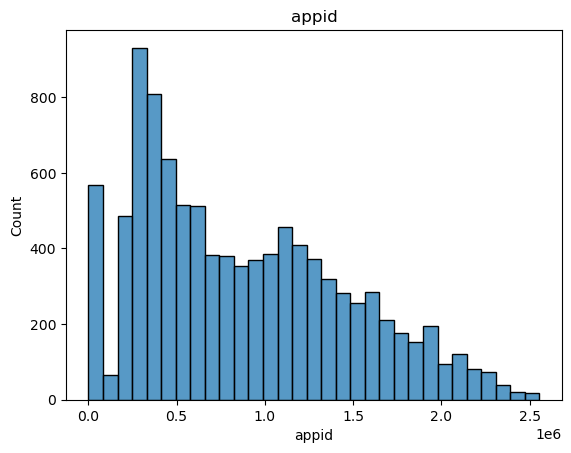

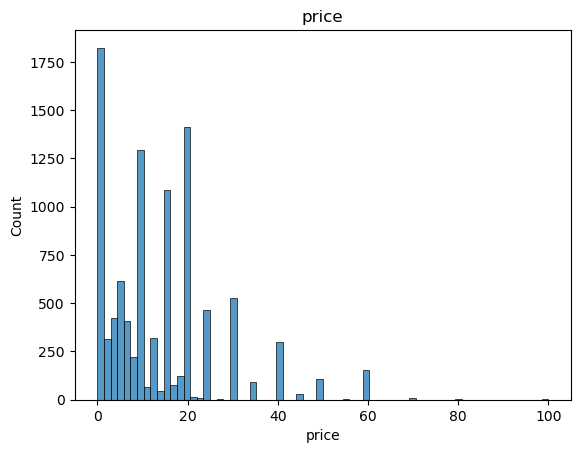

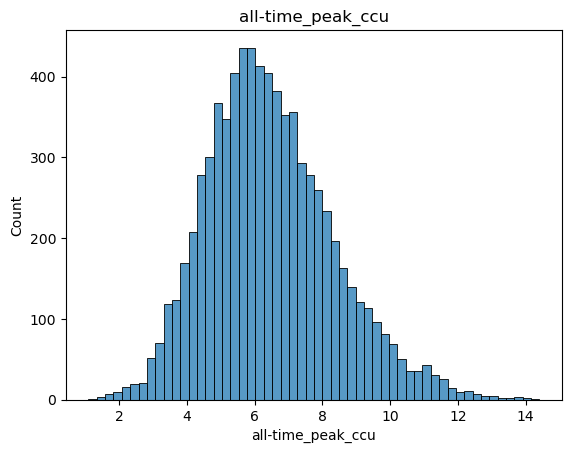

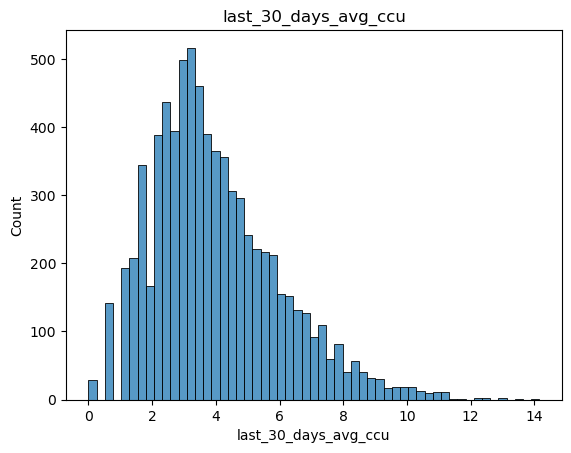

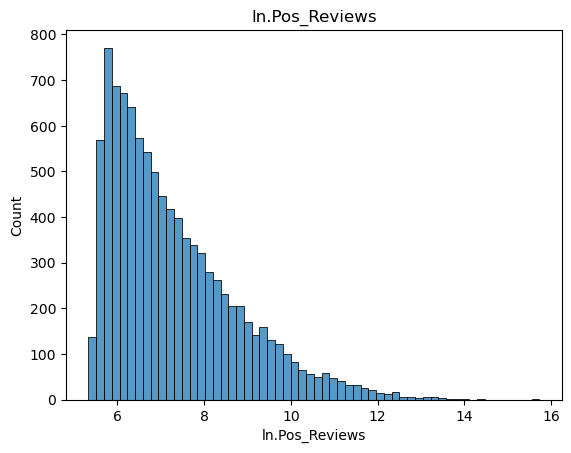

...

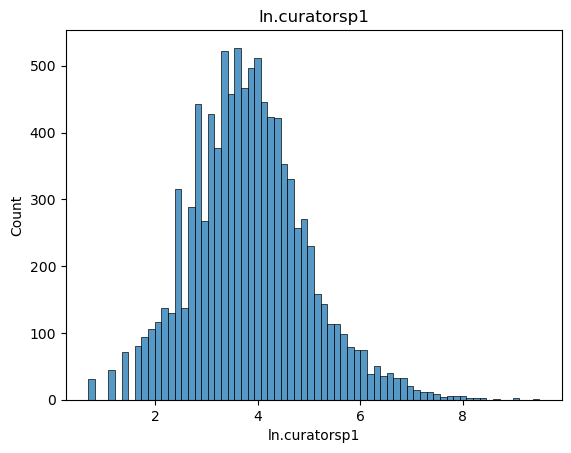

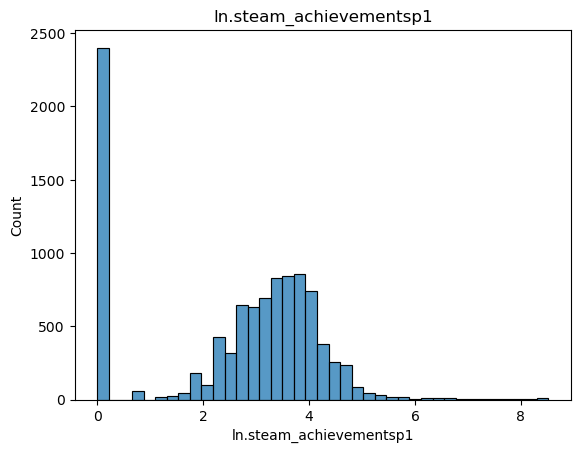

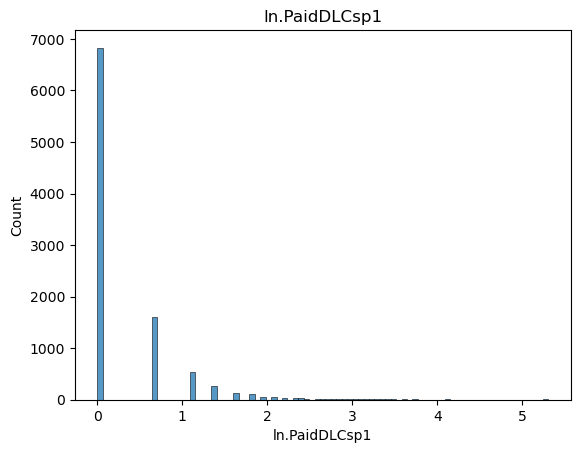

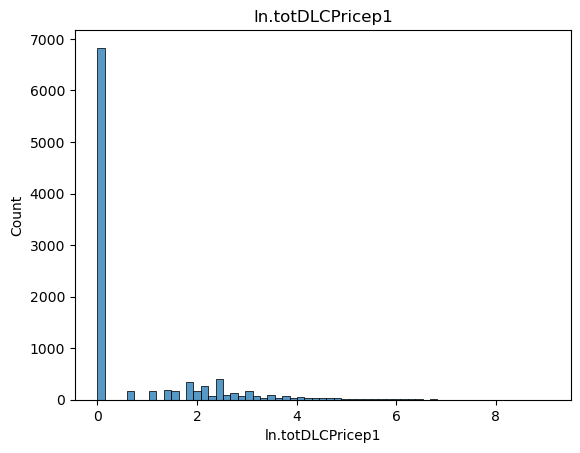

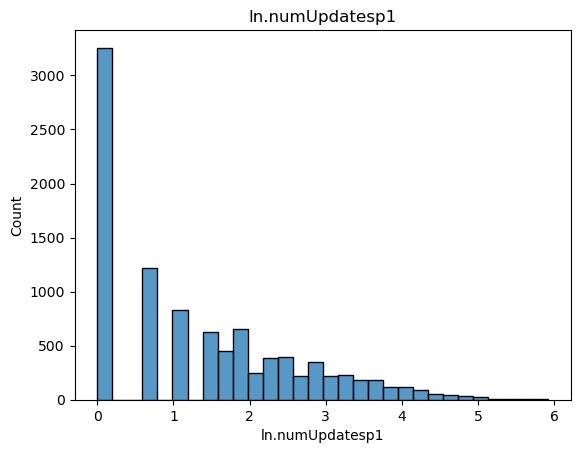

In [171]:
for x in toEda:
    fig, ax = plt.subplots()
    sns.histplot(toEda[x], ax=ax).set_title(x)
    fig

In [132]:
cMatrix

,appid,Pos_Reviews,dlc,price,f2p,unavailable,curators,steam_achievements,Single-player,Online Co-op,...,naccus,esrb_ao,esrb_e,esrb_e10,esrb_ec,esrb_m,esrb_rp,esrb_t,all-time_peak_ccu,last_30_days_avg_ccu
appid,0.000000,-0.059643,-0.011013,0.008924,0.174951,-0.026814,-0.188322,-0.023623,-0.011833,0.040073,...,-0.091587,0.000125,-0.078198,-0.098064,-0.013982,-0.159479,-0.029912,-0.151478,-0.100036,0.068523
Pos_Reviews,-0.059643,0.000000,0.016039,0.064005,0.022927,0.002005,0.765324,0.014435,-0.084631,0.073884,...,-0.054639,-0.002074,-0.007862,0.006157,-0.001857,0.070021,0.001747,0.018284,0.254610,0.280926
dlc,-0.011013,0.016039,0.000000,0.064570,-0.007186,0.018966,0.026754,0.033585,0.001564,0.039740,...,-0.028113,-0.001295,0.003606,-0.001781,-0.000958,0.010007,-0.000701,0.026606,0.046998,0.066106
price,0.008924,0.064005,0.064570,0.000000,-0.450819,0.081788,0.145615,-0.018413,0.122641,0.102385,...,-0.237355,-0.005770,0.036931,0.077357,-0.017826,0.203484,0.013881,0.195973,0.324413,0.348428
f2p,0.174951,0.022927,-0.007186,-0.450819,0.000000,-0.001307,-0.050551,-0.031979,-0.263219,0.068107,...,0.033543,-0.011492,-0.042669,-0.054065,-0.008686,-0.086740,-0.011252,-0.065925,-0.027468,0.017041
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
esrb_m,-0.159479,0.070021,0.010007,0.203484,-0.086740,0.030242,0.191056,-0.005536,0.011303,0.013657,...,-0.084972,-0.007285,-0.057495,-0.055084,-0.005506,0.000000,-0.011359,-0.086316,0.204606,0.173063
esrb_rp,-0.029912,0.001747,-0.000701,0.013881,-0.011252,-0.008435,0.019244,-0.000523,-0.001572,-0.007761,...,-0.000041,-0.001096,-0.008653,-0.008291,-0.000829,-0.011359,0.000000,-0.012991,0.010182,-0.010623
esrb_t,-0.151478,0.018284,0.026606,0.195973,-0.065925,0.002222,0.052871,-0.007410,-0.014117,0.018174,...,-0.074413,-0.008332,-0.065758,-0.063000,-0.006298,-0.086316,-0.012991,0.000000,0.150501,0.128393
all-time_peak_ccu,-0.100036,0.254610,0.046998,0.324413,-0.027468,-0.018311,0.409187,0.076070,-0.135874,0.224877,...,NaN,-0.009050,-0.035867,0.035087,-0.002879,0.204606,0.010182,0.150501,0.000000,0.757177


In [173]:
data.to_csv("Final.csv")

In [103]:
data = pd.read_csv("Final.csv")

In [104]:
data = data.drop("Unnamed: 0", axis=1)

In [5]:
origData = pd.read_csv("bigCleaning.csv")

C:\Users\1king\AppData\Local\Temp\ipykernel_31136\4017451131.py:1: DtypeWarning: Columns (30,31,120,131,137,142,143,144,149,153,154,155,159,160,161,162,174,175,182,183,184,185,186,189,190,194,195,196,197,200,201,202,205,206,207,209,212,216,225,228,230,234,239,245,251,252,255,256,260,261,266,267,268,271,272,273,274,278,279,281,282,285,286,291,295,297,298,299,301,302,306,307,310,311,314,327,330,331,337,338,342,351,352,353,357,358,360,365,366,367,368,371,373,374,384,387,390,392,396,402,403,405,411,413,416,417,425,428,429,430,431,434,435,436,442,446,447,455,458,462,463,466,467,473,474,477,480,481,482,488,490,491,493,498,499,500,501,503,506,507,711,718,721,723,726,733,734,743,744,745,763,764,769,776,789,790,791,796,798,799,800,802,803,808,813,815,817,820,823,824,825,829,830,831,837,840,841,842,843,850,851,855,857,867,869,874,877,880,887,891,893,920,925,926,935,939,942,952,953,957,961,976,977,985,989,990,992,994,995,999,1002,1003,1005,1010,1015,1024,1026,1027,1028,1030,1031,1034,1035,1038,10

In [6]:
origData = origData.drop("Unnamed: 0", axis=1)

In [10]:
origData["fullAudio"] = np.sum([origData[x] for x in origData.keys() if x.endswith("fullAudio")])

In [33]:
origData["interface"] = np.sum([origData[x] for x in origData.keys() if x.endswith("interface")], axis=0)

In [38]:
origData["subtitles"] = np.sum([origData[x] for x in origData.keys() if x.endswith("subtitles")], axis=0)

In [39]:
toDrop = [x for x in origData.keys() if x.endswith("fullAudio") or x.endswith("interface") or x.endswith("subtitles")]

In [46]:
origData = origData.drop(toDrop, axis=1)

<Axes: >

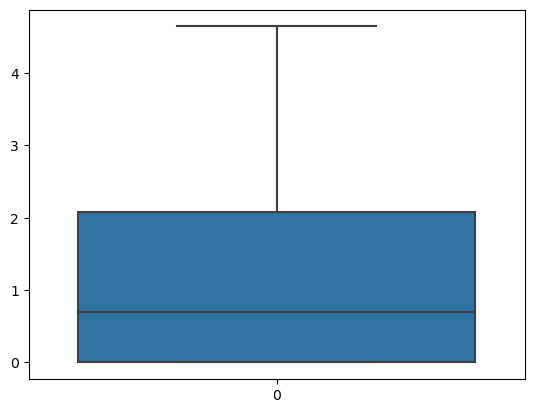

In [68]:
sns.boxplot(np.log(origData["subtitles"] + 1))

In [71]:
origData["ln.subtitlesp1"] = np.log(origData["subtitles"] + 1)

In [72]:
origData = origData.drop("subtitles", axis=1)

In [73]:
origData

,appid,Name,Pos_Reviews,Neg_Reviews,Tot_Reviews,all-time_peak_ccu,last_30_days_avg_ccu,game_name,dlc,price,...,dev_Romantic Room,pub_Romantic Room,dev_Ironward,dev_Racing Bros,pub_ANPA.US,numUpdates,lastUpdate,ln.fullAudiop1,ln.interfacep1,ln.subtitlesp1
0,620,Portal 2,358880,4571,363451,14984.0,5869.0,Portal 2,1.0,9.99,...,False,False,False,False,False,17.0,1.682533e+09,1.791759,3.332205,3.332205
1,1118200,People Playground,211277,2723,214000,15643.0,15643.0,People Playground,0.0,9.99,...,False,False,False,False,False,51.0,1.691801e+09,0.000000,0.693147,0.000000
2,1794680,Vampire Survivors,208300,2928,211228,77061.0,12070.0,Vampire Survivors,3.0,4.99,...,False,False,False,False,False,13.0,1.694679e+09,0.000000,2.564949,0.000000
3,413150,Stardew Valley,597498,10823,608321,94479.0,48881.0,Stardew Valley,1.0,14.99,...,False,False,False,False,False,21.0,1.640117e+09,0.000000,2.564949,0.000000
4,1145360,Hades,231236,3554,234790,37586.0,6541.0,Hades,1.0,24.99,...,False,False,False,False,False,20.0,1.644963e+09,0.693147,2.484907,2.484907
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10425,294020,Merchants of Kaidan,333,160,493,1694.0,16.0,Merchants of Kaidan,0.0,14.99,...,False,False,False,False,False,10.0,1.425585e+09,0.693147,0.693147,0.693147
10426,451780,Trillion,305,146,451,NaN,NaN,Trillion: God of Destruction,1.0,9.99,...,False,False,False,False,False,0.0,0.000000e+00,1.098612,0.693147,0.693147
10427,1075140,Super Friends Party,269,128,397,NaN,NaN,Super Friends Party,0.0,NaN,...,False,False,False,False,False,0.0,0.000000e+00,0.000000,0.693147,0.000000
10428,264140,Pixel Piracy,4815,2490,7305,2146.0,22.0,Pixel Piracy,2.0,14.99,...,False,False,False,False,False,13.0,1.684143e+09,0.693147,2.079442,0.000000


In [74]:
data

,appid,Name,price,f2p,unavailable,release_date,Single-player,Online Co-op,Shared/Split Screen Co-op,Steam Achievements,...,last_30_days_avg_ccu,ln.Pos_Reviews,ln.dlc,ln.dlcp1,ln.curatorsp1,ln.steam_achievementsp1,ln.PaidDLCsp1,ln.totDLCPricep1,ln.numUpdatesp1,hasLastUpdateTimestamp
0,620,Portal 2,9.99,False,False,2011-04-18,True,True,True,True,...,8.677610,12.790743,0.693147,0.693147,8.276649,3.951244,0.000000,0.000000,2.890372,True
1,1118200,People Playground,9.99,False,False,2019-07-23,True,False,False,True,...,9.657843,12.260925,0.000000,0.000000,5.843544,2.890372,0.000000,0.000000,3.951244,True
2,1794680,Vampire Survivors,4.99,False,False,2022-10-20,True,False,False,True,...,9.398561,12.246735,1.386294,1.386294,6.523562,5.283204,1.386294,1.941615,2.639057,True
3,413150,Stardew Valley,14.99,False,False,2016-02-26,True,True,True,True,...,10.797165,13.300506,0.693147,0.693147,7.843456,3.713572,0.693147,1.790091,3.091042,True
4,1145360,Hades,24.99,False,False,2020-09-17,True,False,False,False,...,8.785998,12.351194,0.693147,0.693147,6.854355,3.912023,0.000000,0.000000,3.044522,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9956,294020,Merchants of Kaidan,14.99,False,False,2014-11-10,True,False,False,True,...,2.833213,5.808142,0.000000,0.000000,3.044522,3.135494,0.000000,0.000000,2.397895,True
9957,451780,Trillion,9.99,False,False,2016-11-07,True,False,False,True,...,NaN,5.720312,0.693147,0.693147,3.871201,3.610918,0.693147,2.396986,0.000000,False
9958,1075140,Super Friends Party,0.00,True,False,2019-06-14,False,False,False,False,...,NaN,5.594711,0.000000,0.000000,1.609438,0.000000,0.000000,0.000000,0.000000,False
9959,264140,Pixel Piracy,14.99,False,False,2015-04-23,True,False,False,True,...,3.135494,8.479491,1.098612,1.098612,5.442418,3.465736,1.098612,2.195000,2.639057,True


In [76]:
origData[["ln.fullAudiop1", "ln.interfacep1", "ln.subtitlesp1", "appid"]]

,ln.fullAudiop1,ln.interfacep1,ln.subtitlesp1,appid
0,1.791759,3.332205,3.332205,620
1,0.000000,0.693147,0.000000,1118200
2,0.000000,2.564949,0.000000,1794680
3,0.000000,2.564949,0.000000,413150
4,0.693147,2.484907,2.484907,1145360
...,...,...,...,...
10425,0.693147,0.693147,0.693147,294020
10426,1.098612,0.693147,0.693147,451780
10427,0.000000,0.693147,0.000000,1075140
10428,0.693147,2.079442,0.000000,264140


<Axes: xlabel='price', ylabel='Count'>

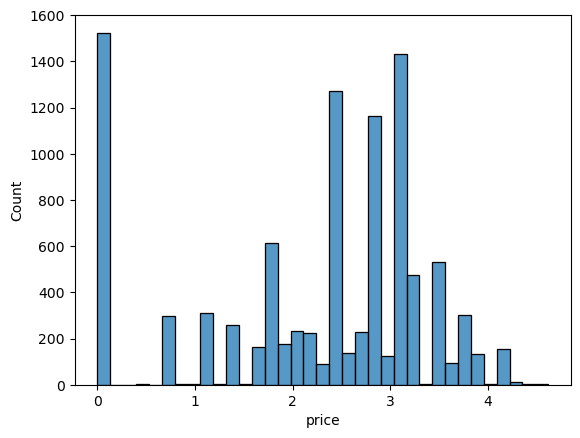

In [82]:
sns.histplot(np.log(data["price"] + 1))

In [105]:
data["ln.pricep1"] = np.log(data["price"] + 1)

In [106]:
data = data.drop("price", axis=1)

In [107]:
data = data.merge(origData[["ln.fullAudiop1", "ln.interfacep1", "ln.subtitlesp1", "appid"]], on="appid")

In [108]:
data

,appid,Name,f2p,unavailable,release_date,Single-player,Online Co-op,Shared/Split Screen Co-op,Steam Achievements,Full controller support,...,ln.curatorsp1,ln.steam_achievementsp1,ln.PaidDLCsp1,ln.totDLCPricep1,ln.numUpdatesp1,hasLastUpdateTimestamp,ln.pricep1,ln.fullAudiop1,ln.interfacep1,ln.subtitlesp1
0,620,Portal 2,False,False,2011-04-18,True,True,True,True,True,...,8.276649,3.951244,0.000000,0.000000,2.890372,True,2.396986,1.791759,3.332205,3.332205
1,1118200,People Playground,False,False,2019-07-23,True,False,False,True,False,...,5.843544,2.890372,0.000000,0.000000,3.951244,True,2.396986,0.000000,0.693147,0.000000
2,1794680,Vampire Survivors,False,False,2022-10-20,True,False,False,True,True,...,6.523562,5.283204,1.386294,1.941615,2.639057,True,1.790091,0.000000,2.564949,0.000000
3,413150,Stardew Valley,False,False,2016-02-26,True,True,True,True,True,...,7.843456,3.713572,0.693147,1.790091,3.091042,True,2.771964,0.000000,2.564949,0.000000
4,1145360,Hades,False,False,2020-09-17,True,False,False,False,True,...,6.854355,3.912023,0.000000,0.000000,3.044522,True,3.257712,0.693147,2.484907,2.484907
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9956,294020,Merchants of Kaidan,False,False,2014-11-10,True,False,False,True,False,...,3.044522,3.135494,0.000000,0.000000,2.397895,True,2.771964,0.693147,0.693147,0.693147
9957,451780,Trillion,False,False,2016-11-07,True,False,False,True,True,...,3.871201,3.610918,0.693147,2.396986,0.000000,False,2.396986,1.098612,0.693147,0.693147
9958,1075140,Super Friends Party,True,False,2019-06-14,False,False,False,False,False,...,1.609438,0.000000,0.000000,0.000000,0.000000,False,0.000000,0.000000,0.693147,0.000000
9959,264140,Pixel Piracy,False,False,2015-04-23,True,False,False,True,False,...,5.442418,3.465736,1.098612,2.195000,2.639057,True,2.771964,0.693147,2.079442,0.000000


In [109]:
data = data.drop([x for x in toDrop if x in data.keys()], axis=1)

In [111]:
data = data.drop(["unavailable"], axis=1)

In [114]:
cMatrix = data.corr()

C:\Users\1king\AppData\Local\Temp\ipykernel_31136\533860344.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  cMatrix = data.corr()


In [120]:
fig, ax = plt.subplots()
fig.set_figwidth(300)
fig.set_figheight(240)

In [121]:
sns.heatmap(cMatrix, ax = ax)

C:\ProgramData\Anaconda3\Lib\site-packages\seaborn\utils.py:80: UserWarning: Glyph 19978 (\N{CJK UNIFIED IDEOGRAPH-4E0A}) missing from current font.
  fig.canvas.draw()
C:\ProgramData\Anaconda3\Lib\site-packages\seaborn\utils.py:80: UserWarning: Glyph 28023 (\N{CJK UNIFIED IDEOGRAPH-6D77}) missing from current font.
  fig.canvas.draw()
C:\ProgramData\Anaconda3\Lib\site-packages\seaborn\utils.py:80: UserWarning: Glyph 12450 (\N{KATAKANA LETTER A}) missing from current font.
  fig.canvas.draw()
C:\ProgramData\Anaconda3\Lib\site-packages\seaborn\utils.py:80: UserWarning: Glyph 12522 (\N{KATAKANA LETTER RI}) missing from current font.
  fig.canvas.draw()
C:\ProgramData\Anaconda3\Lib\site-packages\seaborn\utils.py:80: UserWarning: Glyph 12473 (\N{KATAKANA LETTER SU}) missing from current font.
  fig.canvas.draw()
C:\ProgramData\Anaconda3\Lib\site-packages\seaborn\utils.py:80: UserWarning: Glyph 24187 (\N{CJK UNIFIED IDEOGRAPH-5E7B}) missing from current font.
  fig.canvas.draw()
C:\ProgramD

<Axes: >

In [122]:
fig

C:\ProgramData\Anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 19978 (\N{CJK UNIFIED IDEOGRAPH-4E0A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\ProgramData\Anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 28023 (\N{CJK UNIFIED IDEOGRAPH-6D77}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\ProgramData\Anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 12450 (\N{KATAKANA LETTER A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\ProgramData\Anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 12522 (\N{KATAKANA LETTER RI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\ProgramData\Anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 12473 (\N{KATAKANA LETTER SU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\ProgramData\

In [124]:
for x in cMatrix:
    cMatrix[x][x] = 0

In [132]:
cMatrix[cMatrix > 0.75].dropna(how="all").dropna(how="all", axis=1)

,Steam Achievements,pub_Square Enix,dev_David Szymanski,dev_Eidos-Montréal,dev_Nixxes,dev_Running With Scissors,pub_Running With Scissors,dev_Insomniac Games,dev_Nixxes Software,dev_Traveller's Tales,...,pub_Tribute Games Inc.,all-time_peak_ccu,last_30_days_avg_ccu,ln.Pos_Reviews,ln.dlc,ln.dlcp1,ln.curatorsp1,ln.steam_achievementsp1,ln.PaidDLCsp1,ln.totDLCPricep1
Steam Achievements,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.789967,NaN,NaN
pub_Square Enix,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
dev_David Szymanski,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
dev_Eidos-Montréal,NaN,NaN,NaN,NaN,0.774519,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
dev_Nixxes,NaN,NaN,NaN,0.774519,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ln.dlcp1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,0.814714,NaN
ln.curatorsp1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.761419,NaN,NaN,NaN,NaN,NaN,NaN
ln.steam_achievementsp1,0.789967,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ln.PaidDLCsp1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.814714,0.814714,NaN,NaN,NaN,0.937049


In [175]:
toEda = data.dtypes[(data.dtypes == np.float64) | (data.dtypes == np.int64)].drop(["esrb_ao", "esrb_e", "esrb_e10", "esrb_ec", "esrb_m", "esrb_rp", "esrb_t", "appid"])

In [176]:
toEda

release_date               float64
ln.Pos_Reviews             float64
ln.dlcp1                   float64
ln.curatorsp1              float64
ln.steam_achievementsp1    float64
ln.PaidDLCsp1              float64
ln.totDLCPricep1           float64
ln.numUpdatesp1            float64
ln.pricep1                 float64
ln.fullAudiop1             float64
ln.interfacep1             float64
ln.subtitlesp1             float64
ln.all-time_peak_ccu       float64
ln.last_30_days_avg_ccu    float64
dtype: object

In [139]:
data["ln.all-time_peak_ccu"] = data["all-time_peak_ccu"]

In [140]:
data = data.drop("all-time_peak_ccu", axis=1)

In [142]:
data["ln.last_30_days_avg_ccu"] = data["last_30_days_avg_ccu"]

In [143]:
data = data.drop("last_30_days_avg_ccu", axis=1)

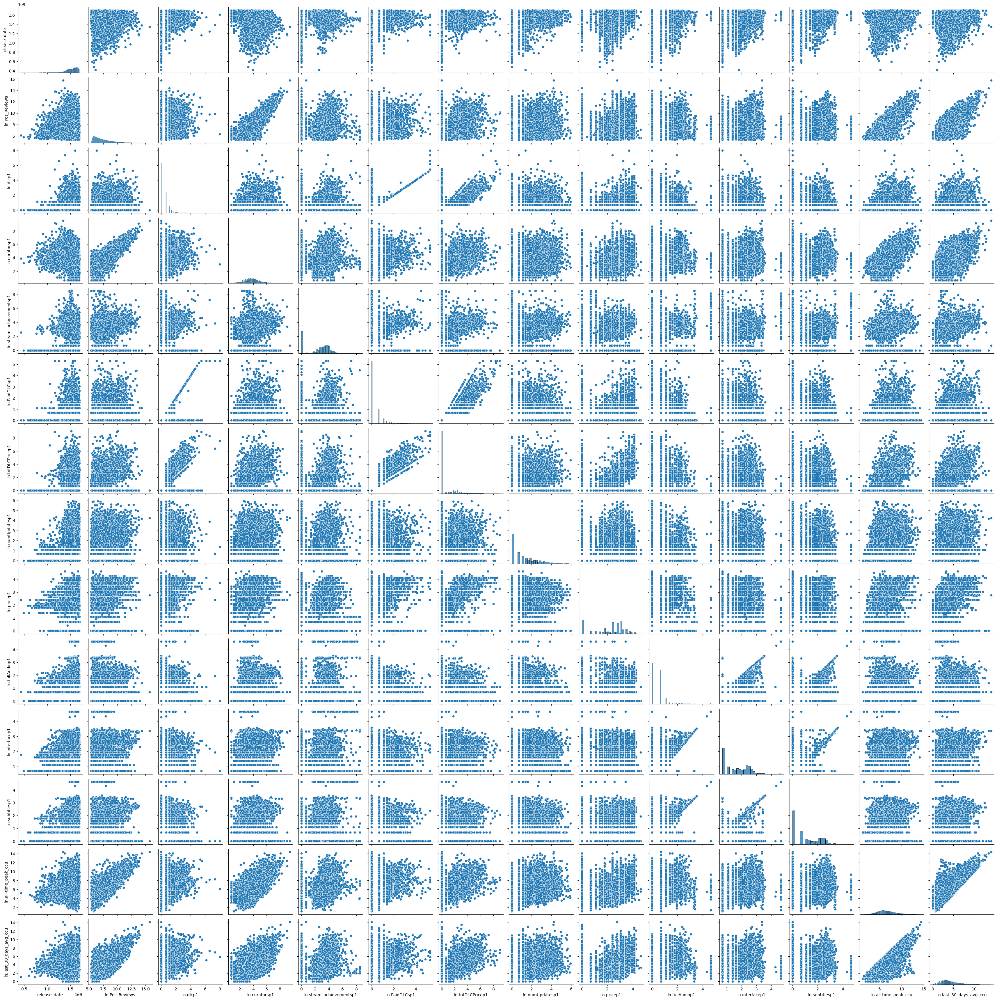

In [177]:
sns.pairplot(data[toEda.keys()])

In [169]:
def timestamp(x):
    return x.timestamp()
data["release_date"] = pd.to_datetime(data["release_date"]).apply(timestamp)

In [178]:
data.to_csv("FinalFinal.csv")